In [437]:
  #import libraries 
    
import pandas as pd
import requests
from bs4 import BeautifulSoup as BS
import numpy as np
import re  

  
from shapely.geometry import Point
import geopandas as gpd
import matplotlib.pyplot as plt
import folium

In [438]:
# create a Request object for the wikipedia page for the Turing Award
response = requests.get('https://en.wikipedia.org/wiki/List_of_deadly_earthquakes_since_1900')

# read the resulting HTML into a variable called result_text
result_text = response.text

In [439]:
print(type(response))

print(type(result_text))

<class 'requests.models.Response'>
<class 'str'>


In [440]:
result_text

'<!DOCTYPE html>\n<html class="client-nojs" lang="en" dir="ltr">\n<head>\n<meta charset="UTF-8"/>\n<title>List of deadly earthquakes since 1900 - Wikipedia</title>\n<script>document.documentElement.className = document.documentElement.className.replace( /(^|\\s)client-nojs(\\s|$)/, "$1client-js$2" );</script>\n<script>(window.RLQ=window.RLQ||[]).push(function(){mw.config.set({"wgCanonicalNamespace":"","wgCanonicalSpecialPageName":false,"wgNamespaceNumber":0,"wgPageName":"List_of_deadly_earthquakes_since_1900","wgTitle":"List of deadly earthquakes since 1900","wgCurRevisionId":840128723,"wgRevisionId":840128723,"wgArticleId":11673441,"wgIsArticle":true,"wgIsRedirect":false,"wgAction":"view","wgUserName":null,"wgUserGroups":["*"],"wgCategories":["Articles needing additional references from July 2017","All articles needing additional references","Articles needing cleanup from July 2017","All pages needing cleanup","Cleanup tagged articles with a reason field from July 2017","Wikipedia pag

In [441]:
# create the soup by constructing a BS object from the html page and the appropriate parser
soup = BS(result_text, 'html.parser')

In [442]:
soup.title

<title>List of deadly earthquakes since 1900 - Wikipedia</title>

In [443]:
print(soup.prettify())

<!DOCTYPE html>
<html class="client-nojs" dir="ltr" lang="en">
 <head>
  <meta charset="utf-8"/>
  <title>
   List of deadly earthquakes since 1900 - Wikipedia
  </title>
  <script>
   document.documentElement.className = document.documentElement.className.replace( /(^|\s)client-nojs(\s|$)/, "$1client-js$2" );
  </script>
  <script>
   (window.RLQ=window.RLQ||[]).push(function(){mw.config.set({"wgCanonicalNamespace":"","wgCanonicalSpecialPageName":false,"wgNamespaceNumber":0,"wgPageName":"List_of_deadly_earthquakes_since_1900","wgTitle":"List of deadly earthquakes since 1900","wgCurRevisionId":840128723,"wgRevisionId":840128723,"wgArticleId":11673441,"wgIsArticle":true,"wgIsRedirect":false,"wgAction":"view","wgUserName":null,"wgUserGroups":["*"],"wgCategories":["Articles needing additional references from July 2017","All articles needing additional references","Articles needing cleanup from July 2017","All pages needing cleanup","Cleanup tagged articles with a reason field from July 20

In [444]:
# My_table = soup.find('table',{'class':'wikitable sortable'})



In [445]:
# find a table 

table=soup.findAll('table',attrs={'class':'sortable wikitable'})


In [446]:
table

[<table class="sortable wikitable">
 <tbody><tr bgcolor="#CCCCCC">
 <th width="22%">Origin (<a class="mw-redirect" href="/wiki/UTC" title="UTC">UTC</a>)</th>
 <th width="33%">Present-day country and link to Wikipedia article</th>
 <th width="10%"><a href="/wiki/Latitude" title="Latitude">Lat</a></th>
 <th width="10%"><a href="/wiki/Longitude" title="Longitude">Long</a></th>
 <th width="8%">Depth (<a class="mw-redirect" href="/wiki/Km" title="Km">km</a>)</th>
 <th width="6%">Magnitude</th>
 <th width="9%">Secondary Effects</th>
 <th width="10%">PDE Shaking Deaths</th>
 <th width="10%">PDE Total Deaths</th>
 <th width="10%">Utsu Total Deaths</th>
 <th width="10%">EM-DAT Total Deaths</th>
 <th width="12%">Other Source Deaths
 </th></tr>
 <tr>
 <td>1900-05-11 17:23</td>
 <td>Japan</td>
 <td>38.700</td>
 <td>141.100</td>
 <td>5</td>
 <td>7.0 <a href="/wiki/Seismic_magnitude_scales#Mjma" title="Seismic magnitude scales"><span title="JMA mag.">M<sub>JMA</sub></span></a></td>
 <td></td>
 <td><

In [447]:
# find table row

table_rows=table[0].findAll('tr')

In [448]:
table_rows

[<tr bgcolor="#CCCCCC">
 <th width="22%">Origin (<a class="mw-redirect" href="/wiki/UTC" title="UTC">UTC</a>)</th>
 <th width="33%">Present-day country and link to Wikipedia article</th>
 <th width="10%"><a href="/wiki/Latitude" title="Latitude">Lat</a></th>
 <th width="10%"><a href="/wiki/Longitude" title="Longitude">Long</a></th>
 <th width="8%">Depth (<a class="mw-redirect" href="/wiki/Km" title="Km">km</a>)</th>
 <th width="6%">Magnitude</th>
 <th width="9%">Secondary Effects</th>
 <th width="10%">PDE Shaking Deaths</th>
 <th width="10%">PDE Total Deaths</th>
 <th width="10%">Utsu Total Deaths</th>
 <th width="10%">EM-DAT Total Deaths</th>
 <th width="12%">Other Source Deaths
 </th></tr>, <tr>
 <td>1900-05-11 17:23</td>
 <td>Japan</td>
 <td>38.700</td>
 <td>141.100</td>
 <td>5</td>
 <td>7.0 <a href="/wiki/Seismic_magnitude_scales#Mjma" title="Seismic magnitude scales"><span title="JMA mag.">M<sub>JMA</sub></span></a></td>
 <td></td>
 <td></td>
 <td></td>
 <td></td>
 <td></td>
 <td>

In [449]:
# define a function to identify table head(th) and table data(td)

data=[]

for ind, tr in enumerate(table_rows):
    tag='td' if ind else 'th'
    row=[elem.text for elem in tr.findAll(tag)]
    data.append(row)
earthquakes_df=pd.DataFrame(data[1:],columns=data[0])
earthquakes_df.head()

,Origin (UTC),Present-day country and link to Wikipedia article,Lat,Long,Depth (km),Magnitude,Secondary Effects,PDE Shaking Deaths,PDE Total Deaths,Utsu Total Deaths,EM-DAT Total Deaths,Other Source Deaths
0,1900-05-11 17:23,Japan,38.700,141.100,5,7.0 MJMA,,,,,,\n
1,1900-07-12 06:25,Turkey,40.300,43.100,,5.9 Muk,,,,140,,\n
2,1900-10-29 09:11,Venezuela,11.000,-66.000,0,7.7 Mw,,,,,,\n
3,1901-02-15 00:00,China,26.000,100.100,0,6.5 Ms,,,,,,\n
4,1901-03-31 07:11,Bulgaria,43.400,28.700,,6.4 Muk,,,,4,,\n


In [450]:
# remove \n string with empty string

earthquakes_df['Other Source Deaths\n']=earthquakes_df['Other Source Deaths\n'].str.replace('\n','')

In [451]:
earthquakes_df=earthquakes_df.replace("", np.nan)
earthquakes_df.head()

,Origin (UTC),Present-day country and link to Wikipedia article,Lat,Long,Depth (km),Magnitude,Secondary Effects,PDE Shaking Deaths,PDE Total Deaths,Utsu Total Deaths,EM-DAT Total Deaths,Other Source Deaths
0,1900-05-11 17:23,Japan,38.700,141.100,5,7.0 MJMA,NaN,NaN,NaN,NaN,NaN,NaN
1,1900-07-12 06:25,Turkey,40.300,43.100,NaN,5.9 Muk,NaN,NaN,NaN,140,NaN,NaN
2,1900-10-29 09:11,Venezuela,11.000,-66.000,0,7.7 Mw,NaN,NaN,NaN,NaN,NaN,NaN
3,1901-02-15 00:00,China,26.000,100.100,0,6.5 Ms,NaN,NaN,NaN,NaN,NaN,NaN
4,1901-03-31 07:11,Bulgaria,43.400,28.700,NaN,6.4 Muk,NaN,NaN,NaN,4,NaN,NaN


In [452]:
# see the column names
earthquakes_df.columns

Index(['Origin (UTC)', 'Present-day country and link to Wikipedia article',
       'Lat', 'Long', 'Depth (km)', 'Magnitude', 'Secondary Effects',
       'PDE Shaking Deaths', 'PDE Total Deaths', 'Utsu Total Deaths',
       'EM-DAT Total Deaths', 'Other Source Deaths\n'],
      dtype='object')

In [453]:
# replace the + sign at the end of numbers on 'Other Source Deaths\n' column

earthquakes_df['Other Source Deaths\n']=earthquakes_df['Other Source Deaths\n'].str.replace('+','')

In [454]:
# remove anything in closed bracket and including the bracket itself.
earthquakes_df['Other Source Deaths\n']=earthquakes_df['Other Source Deaths\n'].replace('\[\d+\]','',regex=True)

In [455]:
earthquakes_df['Other Source Deaths\n'].unique()

array([nan, '3500', '8000', '46', '164', '1500', '105000', '1404', '1',
       '120', '200', None, '380', '2041', '33', '45000', '2489',
       '26271 26000', '68', '231000* 283000* 227898*', '41', '60', '215',
       '34', '295', '79', '189', '1,115', '222,517', '521', '42', '2,698',
       '181', '15894', '150', '111', '601 (as of October 30, 2011)'],
      dtype=object)

In [456]:
# remove everything in the parenthesis

earthquakes_df['Other Source Deaths\n']=earthquakes_df['Other Source Deaths\n'].replace('\(.*?\)','',regex=True)

In [457]:
earthquakes_df['Other Source Deaths\n'].unique()

array([nan, '3500', '8000', '46', '164', '1500', '105000', '1404', '1',
       '120', '200', None, '380', '2041', '33', '45000', '2489',
       '26271 26000', '68', '231000* 283000* 227898*', '41', '60', '215',
       '34', '295', '79', '189', '1,115', '222,517', '521', '42', '2,698',
       '181', '15894', '150', '111', '601 '], dtype=object)

In [458]:
# remove * from the string 

earthquakes_df['Other Source Deaths\n']=earthquakes_df['Other Source Deaths\n'].replace(r'\*',value='',regex=True)

In [459]:
earthquakes_df['Other Source Deaths\n'].unique()

array([nan, '3500', '8000', '46', '164', '1500', '105000', '1404', '1',
       '120', '200', None, '380', '2041', '33', '45000', '2489',
       '26271 26000', '68', '231000 283000 227898', '41', '60', '215',
       '34', '295', '79', '189', '1,115', '222,517', '521', '42', '2,698',
       '181', '15894', '150', '111', '601 '], dtype=object)

In [460]:
# replace  three values listed with average of the three.

earthquakes_df['Other Source Deaths\n']=earthquakes_df['Other Source Deaths\n'].str.replace('231000 283000 227898','247299')

In [461]:


earthquakes_df['Other Source Deaths\n']=earthquakes_df['Other Source Deaths\n'].str.replace('26271 26000','26136')

earthquakes_df['Other Source Deaths\n']=earthquakes_df['Other Source Deaths\n'].str.replace(',','')

In [462]:
earthquakes_df['Other Source Deaths\n'].unique()

array([nan, '3500', '8000', '46', '164', '1500', '105000', '1404', '1',
       '120', '200', None, '380', '2041', '33', '45000', '2489', '26136',
       '68', '247299', '41', '60', '215', '34', '295', '79', '189',
       '1115', '222517', '521', '42', '2698', '181', '15894', '150',
       '111', '601 '], dtype=object)

In [463]:
# replace  5 ML with 5.0 ML  in magnitude column

earthquakes_df.Magnitude=earthquakes_df.Magnitude.str.replace('5 ML','5.0 ML')

In [464]:
# make sure 5 ML is replaced 
earthquakes_df[earthquakes_df.Magnitude.str[0]=='5 ML']

,Origin (UTC),Present-day country and link to Wikipedia article,Lat,Long,Depth (km),Magnitude,Secondary Effects,PDE Shaking Deaths,PDE Total Deaths,Utsu Total Deaths,EM-DAT Total Deaths,Other Source Deaths


In [465]:
# take only numbers from magnitude column
earthquakes_df.Magnitude=earthquakes_df.Magnitude.str.extract('(\d+\.\d+)')
pd.to_numeric(earthquakes_df.Magnitude)
earthquakes_df

,Origin (UTC),Present-day country and link to Wikipedia article,Lat,Long,Depth (km),Magnitude,Secondary Effects,PDE Shaking Deaths,PDE Total Deaths,Utsu Total Deaths,EM-DAT Total Deaths,Other Source Deaths
0,1900-05-11 17:23,Japan,38.700,141.100,5,7.0,NaN,NaN,NaN,NaN,NaN,NaN
1,1900-07-12 06:25,Turkey,40.300,43.100,NaN,5.9,NaN,NaN,NaN,140,NaN,NaN
2,1900-10-29 09:11,Venezuela,11.000,-66.000,0,7.7,NaN,NaN,NaN,NaN,NaN,NaN
3,1901-02-15 00:00,China,26.000,100.100,0,6.5,NaN,NaN,NaN,NaN,NaN,NaN
4,1901-03-31 07:11,Bulgaria,43.400,28.700,NaN,6.4,NaN,NaN,NaN,4,NaN,NaN
5,1901-08-09 09:23,Japan,40.500,142.500,35,7.2,T,NaN,NaN,NaN,NaN,NaN
6,1901-11-15 20:15,New Zealand (see 1901 Cheviot earthquake),-43.000,173.000,0,6.8,NaN,NaN,NaN,1,NaN,NaN
7,1902-01-30 14:01,Japan,40.500,141.300,35,6.9,NaN,NaN,NaN,1,NaN,NaN
8,1902-02-13 09:39,Azerbaijan,40.700,48.600,15,6.9,NaN,NaN,NaN,86,NaN,NaN
9,1902-03-09 07:46,Turkey,40.700,33.600,NaN,5.5,NaN,NaN,NaN,4,NaN,NaN


In [466]:
earthquakes_df.columns

Index(['Origin (UTC)', 'Present-day country and link to Wikipedia article',
       'Lat', 'Long', 'Depth (km)', 'Magnitude', 'Secondary Effects',
       'PDE Shaking Deaths', 'PDE Total Deaths', 'Utsu Total Deaths',
       'EM-DAT Total Deaths', 'Other Source Deaths\n'],
      dtype='object')

In [467]:
earthquakes_df['EM-DAT Total Deaths']=earthquakes_df['EM-DAT Total Deaths'].str.replace('\n','')
earthquakes_df['EM-DAT Total Deaths']=earthquakes_df['EM-DAT Total Deaths'].replace('\[\d+\]','',regex=True)
earthquakes_df['EM-DAT Total Deaths']=earthquakes_df['EM-DAT Total Deaths'].str.replace('|','')

In [468]:
earthquakes_df.info

<bound method DataFrame.info of           Origin (UTC) Present-day country and link to Wikipedia article  \
0     1900-05-11 17:23                                             Japan   
1     1900-07-12 06:25                                            Turkey   
2     1900-10-29 09:11                                         Venezuela   
3     1901-02-15 00:00                                             China   
4     1901-03-31 07:11                                          Bulgaria   
5     1901-08-09 09:23                                             Japan   
6     1901-11-15 20:15         New Zealand (see 1901 Cheviot earthquake)   
7     1902-01-30 14:01                                             Japan   
8     1902-02-13 09:39                                        Azerbaijan   
9     1902-03-09 07:46                                            Turkey   
10    1902-04-19 02:23         Guatemala (see 1902 Guatemala earthquake)   
11    1902-07-03 15:36                                  

In [469]:
earthquakes_df.loc[1327]

Origin (UTC)                                                               2009-09-30 10:16
Present-day country and link to Wikipedia article    Indonesia (see 2009 Padang earthquake)
Lat                                                                                     NaN
Long                                                                                    NaN
Depth (km)                                                                              NaN
Magnitude                                                                               7.6
Secondary Effects                                                                       NaN
PDE Shaking Deaths                                                                      NaN
PDE Total Deaths                                                                        NaN
Utsu Total Deaths                                                                       NaN
EM-DAT Total Deaths                                                             

In [470]:
earthquakes_df['EM-DAT Total Deaths']=pd.to_numeric(earthquakes_df['EM-DAT Total Deaths'])
earthquakes_df['Utsu Total Deaths']=pd.to_numeric(earthquakes_df['Utsu Total Deaths'])
earthquakes_df['PDE Total Deaths']=pd.to_numeric(earthquakes_df['PDE Total Deaths'])
earthquakes_df['Other Source Deaths'] =pd.to_numeric(earthquakes_df['Other Source Deaths\n'])



In [471]:
earthquakes_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1340 entries, 0 to 1339
Data columns (total 13 columns):
Origin (UTC)                                         1340 non-null object
Present-day country and link to Wikipedia article    1340 non-null object
Lat                                                  1326 non-null object
Long                                                 1326 non-null object
Depth (km)                                           1250 non-null object
Magnitude                                            1339 non-null object
Secondary Effects                                    373 non-null object
PDE Shaking Deaths                                   739 non-null object
PDE Total Deaths                                     750 non-null float64
Utsu Total Deaths                                    1027 non-null float64
EM-DAT Total Deaths                                  560 non-null float64
Other Source Deaths
                                 37 non-null object
Other So

In [472]:
# create new 'deaths' column  comparing the four death columns and take the highest

earthquakes_df['deaths']=earthquakes_df[['PDE Total Deaths', 'Utsu Total Deaths',
       'EM-DAT Total Deaths', 'Other Source Deaths\n']].max(axis=1)

In [473]:
earthquakes_df.head()

,Origin (UTC),Present-day country and link to Wikipedia article,Lat,Long,Depth (km),Magnitude,Secondary Effects,PDE Shaking Deaths,PDE Total Deaths,Utsu Total Deaths,EM-DAT Total Deaths,Other Source Deaths,Other Source Deaths,deaths
0,1900-05-11 17:23,Japan,38.700,141.100,5,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1900-07-12 06:25,Turkey,40.300,43.100,NaN,5.9,NaN,NaN,NaN,140.0,NaN,NaN,NaN,140.0
2,1900-10-29 09:11,Venezuela,11.000,-66.000,0,7.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1901-02-15 00:00,China,26.000,100.100,0,6.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1901-03-31 07:11,Bulgaria,43.400,28.700,NaN,6.4,NaN,NaN,NaN,4.0,NaN,NaN,NaN,4.0


# check type of data

In [474]:
earthquakes_df['Present-day country and link to Wikipedia article'].unique()

array(['Japan', 'Turkey', 'Venezuela', 'China', 'Bulgaria',
       'New Zealand (see 1901 Cheviot earthquake)', 'Azerbaijan',
       'Guatemala (see 1902 Guatemala earthquake)', 'Australia',
       'Uzbekistan', 'Judea and Samaria',
       'Turkey (see 1903 Manzikert earthquake)', 'Greece', 'Iran',
       'Taiwan', 'Taiwan (see 1904 Douliu earthquake)', 'India',
       'Albania', 'Italy (see 1905 Calabria earthquake)',
       'Ecuador (see 1906 Ecuador–Colombia earthquake)',
       'Taiwan (see 1906 Meishan earthquake)',
       'United States (see 1906 San Francisco earthquake)',
       'Chile (see 1906 Valparaíso earthquake)', 'Indonesia',
       'Jamaica (see 1907 Kingston earthquake)', 'Mexico', 'Philippines',
       'Tajikistan (see 1907 Qaratog earthquake)',
       'Italy (see 1908 Messina earthquake)',
       'Iran (see 1909 Borujerd earthquake)', 'Portugal',
       'France (see 1909 Provence earthquake)', 'Pakistan', 'Algeria',
       'Kazakhstan (see 1911 Kebin earthquake)', 'K

In [475]:
earthquakes_df['Country']=earthquakes_df['Present-day country and link to Wikipedia article'].str.extract('(\D+\D+\()')

In [476]:
earthquakes_df.Country

0                 NaN
1                 NaN
2                 NaN
3                 NaN
4                 NaN
5                 NaN
6       New Zealand (
7                 NaN
8                 NaN
9                 NaN
10        Guatemala (
11                NaN
12                NaN
13                NaN
14                NaN
15                NaN
16           Turkey (
17                NaN
18                NaN
19                NaN
20                NaN
21                NaN
22                NaN
23           Taiwan (
24                NaN
25                NaN
26                NaN
27            Italy (
28                NaN
29          Ecuador (
            ...      
1310              NaN
1311              NaN
1312         Greece (
1313          Japan (
1314              NaN
1315         Greece (
1316          China (
1317          China (
1318     Kyrgyzstan (
1319          China (
1320       Pakistan (
1321     Costa Rica (
1322          Italy (
1323          China (
1324      

In [477]:
# to extract only names of the countries

earthquakes_df['Country']=earthquakes_df['Present-day country and link to Wikipedia article']\
    .str.split('(')\
    .apply(lambda x:x[0])\
    .str.strip()  

In [478]:
earthquakes_df['Country'].unique()

array(['Japan', 'Turkey', 'Venezuela', 'China', 'Bulgaria', 'New Zealand',
       'Azerbaijan', 'Guatemala', 'Australia', 'Uzbekistan',
       'Judea and Samaria', 'Greece', 'Iran', 'Taiwan', 'India',
       'Albania', 'Italy', 'Ecuador', 'United States', 'Chile',
       'Indonesia', 'Jamaica', 'Mexico', 'Philippines', 'Tajikistan',
       'Portugal', 'France', 'Pakistan', 'Algeria', 'Kazakhstan',
       'Kyrgyzstan', 'Iceland', 'Burma', 'Peru', 'El Salvador',
       'Colombia', 'Russian Federation', 'Puerto Rico',
       'Papua New Guinea', 'Georgia', 'Argentina', 'Eritrea',
       'Bangladesh', 'Nicaragua', 'Mandatory Palestine and Transjordan',
       'Turkmenistan', 'Saint Pierre and Miquelon',
       'Kingdom of Yugoslavia', 'Armenia', 'England', 'Solomon Islands',
       'Cuba', 'Nepal', 'Ghana', 'Romania', 'Yemen', 'Canada',
       'Dominican Republic', 'Tajik Soviet Socialist Republic', 'Haiti',
       'Cyprus', 'Fiji', 'Egypt', 'Costa Rica', 'Hungary',
       'Syrian Arab Repu

In [479]:
earthquakes_df

,Origin (UTC),Present-day country and link to Wikipedia article,Lat,Long,Depth (km),Magnitude,Secondary Effects,PDE Shaking Deaths,PDE Total Deaths,Utsu Total Deaths,EM-DAT Total Deaths,Other Source Deaths,Other Source Deaths,deaths,Country
0,1900-05-11 17:23,Japan,38.700,141.100,5,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Japan
1,1900-07-12 06:25,Turkey,40.300,43.100,NaN,5.9,NaN,NaN,NaN,140.0,NaN,NaN,NaN,140.0,Turkey
2,1900-10-29 09:11,Venezuela,11.000,-66.000,0,7.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Venezuela
3,1901-02-15 00:00,China,26.000,100.100,0,6.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,China
4,1901-03-31 07:11,Bulgaria,43.400,28.700,NaN,6.4,NaN,NaN,NaN,4.0,NaN,NaN,NaN,4.0,Bulgaria
5,1901-08-09 09:23,Japan,40.500,142.500,35,7.2,T,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Japan
6,1901-11-15 20:15,New Zealand (see 1901 Cheviot earthquake),-43.000,173.000,0,6.8,NaN,NaN,NaN,1.0,NaN,NaN,NaN,1.0,New Zealand
7,1902-01-30 14:01,Japan,40.500,141.300,35,6.9,NaN,NaN,NaN,1.0,NaN,NaN,NaN,1.0,Japan
8,1902-02-13 09:39,Azerbaijan,40.700,48.600,15,6.9,NaN,NaN,NaN,86.0,NaN,NaN,NaN,86.0,Azerbaijan
9,1902-03-09 07:46,Turkey,40.700,33.600,NaN,5.5,NaN,NaN,NaN,4.0,NaN,NaN,NaN,4.0,Turkey


# extract the Year from Origin(UTC)

earthquakes_df['Year']=earthquakes_df['Origin'].str[:4]
earthquakes_df.head()

In [ ]:
# there is ? string that is probting to convert it into numeric
earthquakes_df.loc[413]

earthquakes_df['Depth (km)']=earthquakes_df['Depth (km)'].str.replace('?','')
earthquakes_df['Depth (km)']=pd.to_numeric(earthquakes_df['Depth (km)'])

In [493]:
# convert to numerical values

earthquakes_df['Magnitude']=pd.to_numeric(earthquakes_df['Magnitude'])

In [494]:
# take selected columns
Death_country=earthquakes_df.loc[:,['Country','Year','Depth (km)','Magnitude','deaths']]
Death_country.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1340 entries, 0 to 1339
Data columns (total 5 columns):
Country       1340 non-null object
Year          0 non-null float64
Depth (km)    1250 non-null object
Magnitude     1339 non-null float64
deaths        1245 non-null float64
dtypes: float64(3), object(2)
memory usage: 52.4+ KB


C:\Users\fevty\Anaconda3\lib\site-packages\pandas\core\indexing.py:1472: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)


In [495]:
grouped_by_country=Death_country.groupby(['Country','Year']).sum()
grouped_by_country

,,Magnitude,deaths
Country,Year,,


In [496]:
grouped_by_country=grouped_by_country.reset_index()

In [497]:
#grouped_by_country.sort_values(['Country','Year'],axis=0)

In [498]:
grouped_by_country.head()

,Country,Year,Magnitude,deaths


In [499]:
### shallower the source of the earth quakes the magnitude of the scale ranges from 2 to 10
### the relationship is not clear

In [502]:
# Depth vs Magnitude
#plt.scatter(Death_country['Depth (km)'],Death_country.Magnitude)


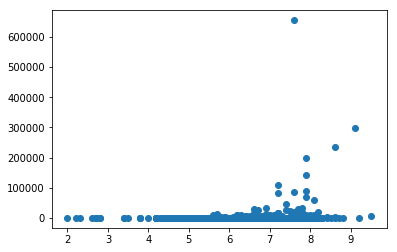

In [503]:
# magnitude of the quakes vs deaths 
plt.scatter(Death_country.Magnitude,Death_country.deaths)

In [527]:
#plt.scatter(grouped_by_country['Depth (km)'],grouped_by_country.deaths)

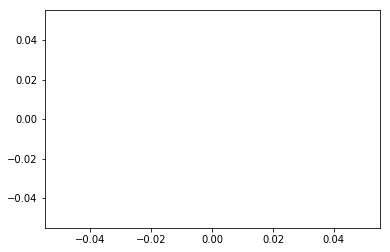

In [505]:
plt.scatter(grouped_by_country.Magnitude,grouped_by_country.deaths)

In [506]:
# where did the highest causlity occured
highest_death=grouped_by_country.nlargest(10,'deaths')

In [507]:
highest_death

,Country,Year,Magnitude,deaths


china_df=grouped_by_country[grouped_by_country.Country=='China']

In [509]:
china_df.head()

,Country,Year,Depth (km),Magnitude,deaths
127,China,1901,0.0,6.5,0.0
128,China,1902,20.0,14.4,5650.0
129,China,1904,0.0,6.8,565.0
130,China,1906,0.0,7.2,285.0
131,China,1909,0.0,6.5,19.0


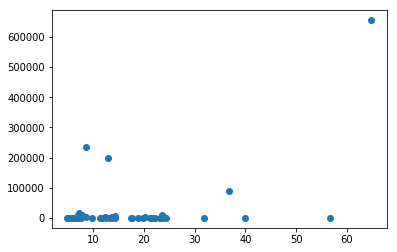

In [510]:
plt.scatter(china_df.Magnitude,china_df.deaths)

indo_df=grouped_by_country[grouped_by_country.Country=='Indonesia']

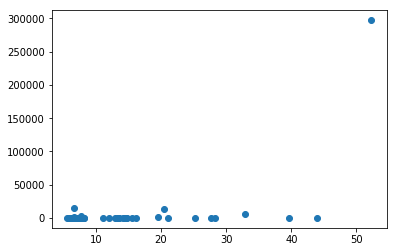

In [512]:
plt.scatter(indo_df.Magnitude,indo_df.deaths)

In [513]:
#earthquakes_df.loc[413]

earthquakes_df['Long']=earthquakes_df['Long'].replace('??',np.nan)

In [514]:
earthquakes_df['Lat']=earthquakes_df.Lat.replace('?',np.nan)

earthquakes_df['Long']=pd.to_numeric(earthquakes_df.Long,errors='coerce')
earthquakes_df['Lat']=pd.to_numeric(earthquakes_df.Lat,errors='coerce')

In [515]:
earth_quake_cord=earthquakes_df[['Lat','Long']]
earth_quake_cord['Long']=pd.to_numeric(earth_quake_cord.Long,errors='coerce')
earth_quake_cord['Lat']=pd.to_numeric(earth_quake_cord.Lat,errors='coerce')

C:\Users\fevty\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\fevty\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


from mpl_toolkits.basemap import Basemap
plt.figure(figsize=(14, 8))
earth = Basemap()
earth.bluemarble(alpha=0.42)
earth.drawcoastlines(color='#555566', linewidth=1)
plt.scatter(earth_quake_cord.Long, earth_quake_cord.Lat, c='red',alpha=0.25, s=2.25**(earthquakes_df.Magnitude))

In [526]:
earthquakes_df.rename(columns={"Origin (UTC)":'Origin'},inplace=True)



earthquake_map=earthquakes_df

earthquake_map=earthquake_map.dropna(subset=['Lat'])
earthquakes_df['geometry'] = earthquakes_df.apply(lambda x: Point((float(x.Long), float(x.Lat))), axis=1)
earthquake_map.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1325 entries, 0 to 1339
Data columns (total 16 columns):
Origin                                               1325 non-null object
Present-day country and link to Wikipedia article    1325 non-null object
Lat                                                  1325 non-null float64
Long                                                 1325 non-null float64
Depth (km)                                           1248 non-null object
Magnitude                                            1324 non-null float64
Secondary Effects                                    370 non-null object
PDE Shaking Deaths                                   739 non-null object
PDE Total Deaths                                     749 non-null float64
Utsu Total Deaths                                    1027 non-null float64
EM-DAT Total Deaths                                  559 non-null float64
Other Source Deaths
                                 27 non-null object
Other

In [518]:
plate_bounds = gpd.read_file('custom.geo.json')

In [519]:
plate_bounds.head()

,scalerank,featurecla,labelrank,sovereignt,sov_a3,adm0_dif,level,type,admin,adm0_a3,...,region_un,subregion,region_wb,name_len,long_len,abbrev_len,tiny,homepart,filename,geometry
0,5,Admin-0 country,6,United Kingdom,GB1,1,2,Dependency,Bermuda,BMU,...,Americas,Northern America,North America,7,7,5,4,-99,BMU.geojson,(POLYGON ((-64.81196571723709 32.2899362996439...
1,3,Admin-0 country,6,Antigua and Barbuda,ATG,0,2,Sovereign country,Antigua and Barbuda,ATG,...,Americas,Caribbean,Latin America & Caribbean,17,19,6,4,1,ATG.geojson,(POLYGON ((-61.77301998599992 17.1265322940001...
2,3,Admin-0 country,6,United Kingdom,GB1,1,2,Dependency,Anguilla,AIA,...,Americas,Caribbean,Latin America & Caribbean,8,8,4,-99,-99,AIA.geojson,(POLYGON ((-63.03766842399995 18.2129580750000...
3,3,Admin-0 country,5,Barbados,BRB,0,2,Sovereign country,Barbados,BRB,...,Americas,Caribbean,Latin America & Caribbean,8,8,5,3,1,BRB.geojson,POLYGON ((-59.42690995999987 13.16038646000007...
4,3,Admin-0 country,5,Netherlands,NL1,1,2,Country,Aruba,ABW,...,Americas,Caribbean,Latin America & Caribbean,5,5,5,4,-99,ABW.geojson,"POLYGON ((-69.9969376289999 12.57758209800004,..."


In [520]:
earthquake_geo = gpd.GeoDataFrame(earthquake_map, crs = plate_bounds.crs, geometry = earthquakes_df['geometry'])

In [521]:
earthquakes_df.columns

Index(['Origin', 'Present-day country and link to Wikipedia article', 'Lat',
       'Long', 'Depth (km)', 'Magnitude', 'Secondary Effects',
       'PDE Shaking Deaths', 'PDE Total Deaths', 'Utsu Total Deaths',
       'EM-DAT Total Deaths', 'Other Source Deaths\n', 'Other Source Deaths',
       'deaths', 'Country', 'geometry'],
      dtype='object')

In [525]:
#create our map of world
map_world = folium.Map(location = [0,0], zoom_start = 2)

#draw  plate boundaries: plate_bounds
folium.GeoJson(plate_bounds).add_to(map_world)

#iterate through our earthquake_map to create locations and markers for each piece
#here lat is listed first!!
#also the apostrophe in the 4th row causes problems!

for row in earthquake_map.iterrows():
    row_values = row[1] 
    location = [row_values['Lat'], row_values['Long']]
    popup = 'Date: ' + str(row_values['Origin']) + '<br/>' +  'Country: ' + str(row_values['Country']) + '<br/>' + 'Magnitude: ' + str(row_values['Magnitude'])+ '<br/>'+ 'Deaths: ' + str(row_values['deaths'])
    mag_radius = 4.5 ** row_values['Magnitude'] 
    death_radius = row_values['deaths']  * 5
    #marker = folium.Marker(location = location, popup = popup)
    if row_values['Magnitude'] > 5.5:
        marker = folium.Circle(location=location, popup=popup, radius=mag_radius, color='crimson', fill=False, fill_color='crimson').add_to(map_world)
        marker.add_to(map_world)
    if row_values['deaths'] > 10000:
        marker = folium.Circle(location=location, popup=popup, radius=death_radius, color='green', fill=False, fill_color='green').add_to(map_world)
        marker.add_to(map_world)

# Show map

map_world

In [524]:
earthquake_map.Magnitude.dtype

dtype('float64')